2 x (300, 600)


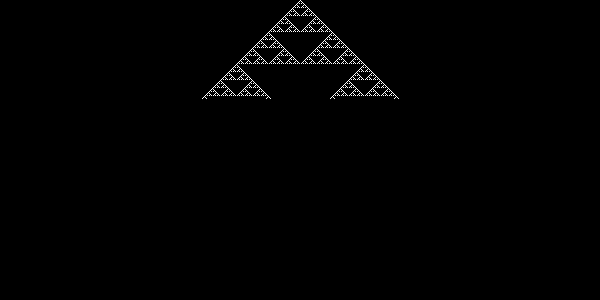

In [38]:
from open import image_open, denormalize
from PIL import Image
import kernel

#frames = image_open("https://upload.wikimedia.org/wikipedia/commons/e/e5/Gospers_glider_gun.gif", 1/5)
#frames = image_open("https://upload.wikimedia.org/wikipedia/commons/b/b4/Highlife_replicator.gif", 1)
#frames = image_open("https://upload.wikimedia.org/wikipedia/commons/8/82/Langton%27s_Ant_colony.gif", 1)
#frames = image_open("https://upload.wikimedia.org/wikipedia/commons/5/5d/Animated_display.gif", 1)
#frames = image_open("https://upload.wikimedia.org/wikipedia/commons/d/d9/The_Belousov-Zhabotinsky_Reaction.gif", 1)
#frames = image_open("https://upload.wikimedia.org/wikipedia/commons/a/a7/Brian%27s_brain.gif", 1)
frames = image_open("https://upload.wikimedia.org/wikipedia/commons/c/ce/R090_pulse_wide.png", 1)[99:101]
#frames = image_open("https://upload.wikimedia.org/wikipedia/commons/1/18/Ca110-interaction2.png", 1)
#frames = image_open("https://upload.wikimedia.org/wikipedia/commons/a/aa/Rule30-256-rows.png", 1)
#frames = image_open("https://upload.wikimedia.org/wikipedia/commons/a/af/Fractal_weeds.jpg", 1/3)
#Ks = kernel.Conway
Ks = kernel.R90
K = Ks[0]

print("{} x {}".format(len(frames), frames[0].shape))
Image.fromarray(denormalize(frames[0]))

In [ ]:
from visualization.plotly import imshow
imshow(frames, animation_frame=0)

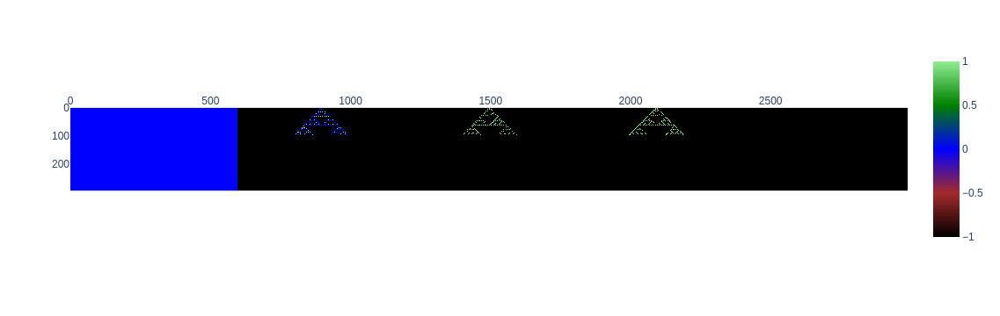

In [41]:
from train.data import pretraining_step
import numpy as np
i = 0
frame0, frame1, N, T, A = pretraining_step(frames[i], frames[i+1], K=K)

def error_img(E, abs=np.absolute, offset=1, power=1, scale=1):
    return abs(E**power)*scale - offset
imshow(np.concatenate([(frame1-frame0)/2, N, T, A, error_img(frame1-A)], axis=1))

In [42]:
from itertools import groupby
from operator import itemgetter
XY = list(zip(N.flatten(),frame0.flatten(),frame1.flatten()))
keyfn = itemgetter(0,1)
trainingdata = [[x, dict(zip(*np.unique(list([i[2] for i in y]), return_counts=True)))] for x,y in groupby(sorted(XY,key=keyfn),keyfn)]
trainingdata

[[(-1.0, -1.0), {-1.0: 176344}],
 [(0.0, -1.0), {1.0: 16}],
 [(0.0, 1.0), {1.0: 1234}],
 [(1.0, -1.0), {-1.0: 610}]]

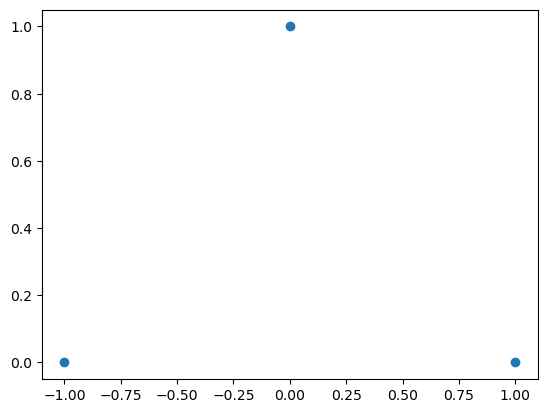

[0.         2.50662828 0.1       ]


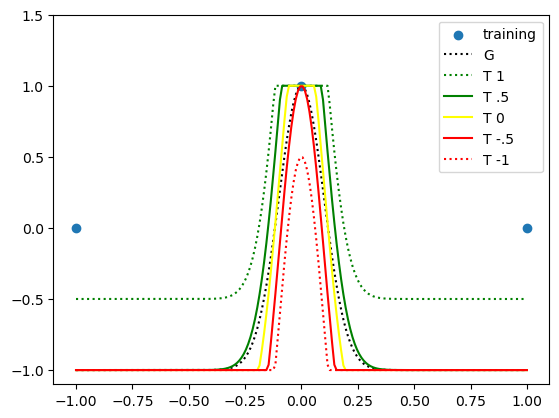

cond(pcov) = inf
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  5 had an illegal value


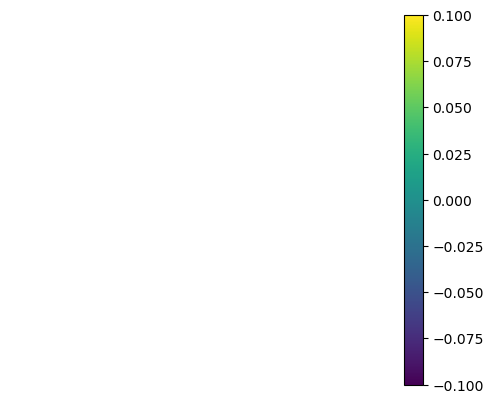

In [43]:
from train.data import training_data
X, Y = training_data(N, frame0, frame1)
#Y = 2*Y+0.3

from train.fit import fit_plot, plot_training_data
plot_training_data(X, Y)
popt, pcov = fit_plot(X, Y, p0=[0, 1.5, 0.1])

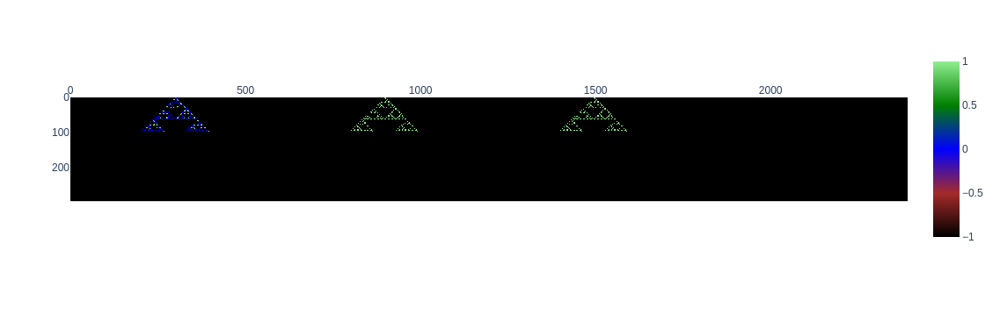

In [44]:
from model import step
from train.data import borderless
(N_, T_, A_) = step(frames[i], p=popt, overshoot=0, offset=0, round=False, dt=1, K=K)
N, T, A = borderless([N_, T_, A_])

E = frame1-A
imshow(np.concatenate([N, T, A, error_img(E)], axis=1))

In [ ]:
from figures.conway import demo
A = frame0
#A = 2*demo-1
from simulation import simulate
A = simulate(A, p=popt, steps=2*A.shape[0], overshoot=0, offset=0, round=True, dt=1, const=A, K=K)
#A = simulate(A, p=popt, steps=2*A.shape[0], overshoot=1, offset=0.4, round=True, dt=1, const=A, K=K)
#A = simulate(A, p=popt, steps=1000, overshoot=1, offset=0.4, round=True, dt=1, const=A, K=K)